In [ ]:
Author: Bahram Jafrasteh

# SEMANTIC LABELING of AERIAL IMAGES

### brief description
The aerial image data contain 180 high resolution images from different cities. 
The training data has mask images which shows the location of building in the image. 

The goal is to build a deep neural network to classify each pixel as the building or no-building.

To achieve this, U-net structure which has been successfully used for medical images and according to literature study is an appropriate methods when number of data is limited is proposed for accomplishing this home-work.

In this study, transfer learning strategy was employed to improve the training efficiency of the network by using pretrained weights from VGG16 network that has been obtained from imagenet data set.

The vgg16 network is in the contraction path of the final network and the expansion part is made by adding layers to the top model of vgg16 in order to generate a u-net strucutre. 
The contraction path help the network to extract desirable features from the data and then the expansion part is helpful in spatial localization.  

The training algorithm is 'ADAM' and the number of epoch set to be 100. Early stopping strategy was proposed to avoid over-fitting.The steps_per_epoch is the number of training data divided by batch_size.

I have briefly explained what happens before starting each section.


Please do not hesitate to contact me by email, b.jafrasteh@gmail.com, for further questions about the written code.


# 1. Loading the required Libs and infos

In [2]:
import os
import sys
import random
import warnings #
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
from itertools import chain
from skimage.io import imread_collection, concatenate_images
from skimage.transform import resize
from skimage.external.tifffile import imread, imsave, imshow, TiffFile
from skimage.morphology import label
from keras.models import Model, load_model
from keras.layers import Input, UpSampling2D
from keras.layers.core import Dropout, Lambda, Activation, SpatialDropout2D
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D
from keras.layers.merge import concatenate
from keras.utils.data_utils import get_file
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import backend as K
from keras.layers.normalization import BatchNormalization
import tensorflow as tf
from skimage import data
import random
import cv2
import h5py
from keras.preprocessing.image import ImageDataGenerator


## 1.1 Paths and infos

In [3]:
IMG_WIDTH = 224
IMG_HEIGHT = 224
RESIZE_WIDHT = 5000
RESIZE_HEIGHT = 5000
max_crop_for_images = 22
divide_image = int(RESIZE_WIDHT/IMG_WIDTH)
IMG_CHANNELS = 3
TRAIN_PATH = 'AerialImageDataset/train/'
#VALID_PATH = '/AerialImageDataset/valid/'
TEST_PATH = '/AerialImageDataset/test/'

TRAIN_OUT = '/AerialImageDataset_red/train/'
VALID_OUT = '/AerialImageDataset_red/validation/'
TEST_OUT = '/AerialImageDataset_red/test/'

warnings.filterwarnings('ignore', category=UserWarning, module='skimage')
seed = 42

# *Cropping images to 224 by 224 

As the size of the images are so high that my laptop can not handle them, I have used the cropped part of images to construct trainig, validation and test sets.

In [3]:
train_ids = next(os.walk(TRAIN_PATH+'images/'))[2]
test_ids = next(os.walk(TEST_PATH+'images/'))[2]

## *Training and validation data

In [ ]:
sys.stdout.flush()
pos = 0
format_file = '.tif'
for n, id_ in tqdm(enumerate(train_ids), total=len(train_ids)):
    path = TRAIN_PATH + 'images/' + id_
    path_in_train = TRAIN_OUT + 'images/images/'
    path_out_train = TRAIN_OUT + 'gt/gt/'
    path_in_valid = VALID_OUT + 'images/images/'
    path_out_valid = VALID_OUT + 'gt/gt/'
    img = imread(path)[:,:,:IMG_CHANNELS]
    
    #img = cv2.resize(img, (RESIZE_HEIGHT, RESIZE_WIDHT), interpolation = cv2.INTER_AREA)
    
    path = TRAIN_PATH + 'gt/' + id_
    img_test = imread(path)#, as_gray=True)
    #img_test = cv2.cvtColor(img_test,cv2.COLOR_BGR2GRAY)
    #img_test = np.expand_dims(img_test, axis=-1)    
    crop = 1
    ix = [i for i in range(divide_image)]
    iy = [i for i in range(divide_image)]
    random.shuffle(ix)
    
    for i in range(divide_image):
        x_start = ix[i]*IMG_WIDTH
        x_end = (ix[i]+1)*IMG_WIDTH
        r= 1
        for j in range(divide_image):
            random.shuffle(iy)
            y_start = iy[j]*IMG_HEIGHT
            y_end = (iy[j]+1)*IMG_HEIGHT
            #pos = n*divide_image**2 + i*divide_image + j
            #print(pos,i,j)
            # cropping training images
            
            if crop <= max_crop_for_images:
                
                #print(pos, ix[i] , iy[j])
                sub_image = img[y_start: y_end, x_start:x_end,:]
                sub_image_test = img_test[y_start: y_end, x_start:x_end]
                if np.sum(sub_image_test)> 700000:
                    #print(np.sum(sub_image_test))
                    #print(sub_image_test.shape)
                    #print(sub_image.shape)
                    #X_train[pos] = sub_image
                    #Y_train[pos] = sub_image_test
                    #if pos % 4 != 0:
                    if random.random()< 0.5:
                        r += 1
                        #print(pos)
                        if pos % 4 != 0:
                            out_name = path_in_train + id_+'_'+str(pos)+format_file
                            imsave(out_name, sub_image)
                            out_name = path_out_train + id_+'_'+str(pos)+format_file
                            imsave(out_name, sub_image_test)
                        else:
                            out_name = path_in_valid + id_+'_'+str(pos)+format_file
                            imsave(out_name, sub_image)
                            out_name = path_out_valid + id_+'_'+str(pos)+format_file
                            imsave(out_name, sub_image_test)
                        pos += 1
                        crop += 1
                    if r > 1:
                        break
            else:
                break
        if crop > max_crop_for_images:
            break
            
                

 20%|██        | 36/180 [00:43<03:09,  1.32s/it]/home/lenovo/.local/lib/python3.6/site-packages/skimage/external/tifffile/tifffile.py:2616: RuntimeWarning: py_decodelzw encountered unexpected end of stream
  strip = decompress(strip)
 88%|████████▊ | 158/180 [03:22<00:27,  1.23s/it]

## *Test data

In [4]:
sys.stdout.flush()
pos = 0
format_file = '.tif'
for n, id_ in tqdm(enumerate(test_ids), total=len(test_ids)):
    path_in_test = TEST_OUT + 'images/images/'

    path = TEST_PATH + 'images/' + id_
    img = imread(path)[:,:,:IMG_CHANNELS]
    
    crop = 1
    ix = [i for i in range(divide_image)]
    iy = [i for i in range(divide_image)]
    random.shuffle(ix)
    
    for i in range(divide_image):
        x_start = ix[i]*IMG_WIDTH
        x_end = (ix[i]+1)*IMG_WIDTH
        r= 1
        for j in range(divide_image):
            random.shuffle(iy)
            y_start = iy[j]*IMG_HEIGHT
            y_end = (iy[j]+1)*IMG_HEIGHT
            #pos = n*divide_image**2 + i*divide_image + j
            #print(pos,i,j)
            # cropping training images
            
            if crop <= max_crop_for_images:
                
                #print(pos, ix[i] , iy[j])
                sub_image = img[y_start: y_end, x_start:x_end,:]
                if random.random()< 0.5:
                        r += 1
                        out_name = path_in_test + id_+'_'+str(pos)+format_file
                        imsave(out_name, sub_image)
                        pos += 1
                        crop += 1
                if r > 1:
                    break
                
            else:
                break
        if crop > max_crop_for_images:
            break
            
                

100%|██████████| 180/180 [03:01<00:00,  1.01s/it]


# **Data Augmentation

Data augementation helps the model to learn from the data in different situation where images are rotated, shifted and flipped. Therefore, the final model is more robust and have higher prediction accuracy.
In this study, due to memory limitation I have not used this strategy. I just wrote the code for future use.

In [2]:
def combineGenerator(gen1, gen2):
    while True:
        yield(gen1.next(), gen2.next())

In [16]:

train_data_gen_args = dict(rescale=1./255,
      rotation_range=45,
      width_shift_range=0.3,
      height_shift_range=0.3,
      horizontal_flip=True,
      fill_mode='nearest')
image_datagen = ImageDataGenerator(**train_data_gen_args)
mask_datagen = ImageDataGenerator(**train_data_gen_args)


batch_size = 2
image_generator = image_datagen.flow_from_directory(
    TRAIN_OUT + 'images',
    target_size=(IMG_HEIGHT, IMG_WIDTH),
    class_mode = None,
    batch_size = batch_size,
    seed = seed)
mask_generator = mask_datagen.flow_from_directory(
    TRAIN_OUT + 'gt',
    target_size=(IMG_HEIGHT, IMG_WIDTH),
    color_mode = 'grayscale',
    class_mode = None,
    batch_size = batch_size,
    seed = seed)

train_generator = combineGenerator(image_generator, mask_generator)

validation_imgen = ImageDataGenerator(rescale=1./255)
validation_maskgen = ImageDataGenerator(rescale=1./255)

val_image_generator = validation_imgen.flow_from_directory(
    VALID_OUT + 'images/',
    target_size=(IMG_HEIGHT, IMG_WIDTH),
    class_mode = None,
    batch_size = batch_size,
    seed = seed)
val_mask_generator = validation_maskgen.flow_from_directory(
    VALID_OUT + 'gt/',
    target_size=(IMG_HEIGHT, IMG_WIDTH),
    color_mode = 'grayscale',
    class_mode = None,
    batch_size = batch_size,
    seed = seed)

valid_generator = combineGenerator(val_image_generator, val_mask_generator)


Found 1160 images belonging to 1 classes.
Found 1160 images belonging to 1 classes.
Found 386 images belonging to 1 classes.
Found 386 images belonging to 1 classes.


## **JUST FOR DEMONSTRATING AUGMENTED IMAGES

In [18]:
i = 0
for batch in validation_datagen.flow_from_directory(VALID_OUT + 'images/',target_size=(IMG_HEIGHT, IMG_WIDTH),save_to_dir=VALID_OUT + 'images_aug/', save_prefix='hi'):
    i = i + 1
    if i > 10:
        break

Found 386 images belonging to 1 classes.


# 2. Loading and scaling the Data

We need to load and scale the data to use them in image processing model.

## 2.1 SCALING DATA

In [4]:
def scale(image):
    #image = tf.cast(image, tf.float32)
    image = np.float32(image)
    image /= 255.0
    image -= 0.5
    return image

## 2.2 Reading TRAINING data

In [4]:
print('Getting training images ... ')

train_ids = next(os.walk(TRAIN_OUT + 'images/images/'))[2]

size_train = len(train_ids)
#size_train = 102
X_train_s = np.zeros((size_train, IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),
                   dtype=np.uint8)
Y_train_s = np.zeros((size_train, IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)


sys.stdout.flush()
for n, id_ in tqdm(enumerate(train_ids), total=len(train_ids)):
    path = TRAIN_OUT + 'images/images/' + id_
    img = imread(path)

    X_train_s[n] = img
    path = TRAIN_OUT + 'gt/gt/' + id_
    img_out = imread(path)
    img_out = np.expand_dims(img_out, axis=-1)
    #print(img_test.shape)
    Y_train_s[n] = img_out
    #if n > 100:
     #   break


X_train = scale(X_train_s)
Y_train = np.float32(Y_train_s)


Getting training images ... 


100%|██████████| 5468/5468 [00:18<00:00, 293.44it/s]


## 2.3 Reading VALIDATION data

In [ ]:
print('Getting validating images ... ')

valid_ids = next(os.walk(VALID_OUT + 'images/images/'))[2]
X_valid_s = np.zeros((len(valid_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),
                   dtype=np.uint8)
Y_valid_s = np.zeros((len(valid_ids), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)

# Note sys.stdout prints info that can be cleared unlike print.
# Using TQDM allows us to create progress bars
sys.stdout.flush()
for n, id_ in tqdm(enumerate(valid_ids), total=len(valid_ids)):
    path = VALID_OUT + 'images/images/' + id_

    img = imread(path)

    X_valid_s[n] = img#merged[:,:,1:4]
    path = VALID_OUT + 'gt/gt/' + id_
    img_out = imread(path)
    img_out = np.expand_dims(img_out, axis=-1)
    #print(img_test.shape)
    Y_valid_s[n] = img_out

X_valid = scale(X_valid_s)
Y_valid = np.float32(Y_valid_s)   

## 2.4 Reading TEST data

In [5]:
print('Getting test images ... ')
test_ids = next(os.walk(TEST_OUT + 'images/images/'))[2]   
X_test_s = np.zeros((len(test_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),
                   dtype=np.uint8)
sys.stdout.flush()
for n, id_ in tqdm(enumerate(test_ids), total=len(test_ids)):
    path = TEST_OUT + 'images/images/' + id_

    img = imread(path)

    X_test_s[n] = img
    
X_test = scale(X_test_s)

Getting test images ... 


100%|██████████| 3960/3960 [00:07<00:00, 511.60it/s]


# 3. ILLUSTRATING DATA 

We illustrate some of loaded images and their corresponding masks in this section

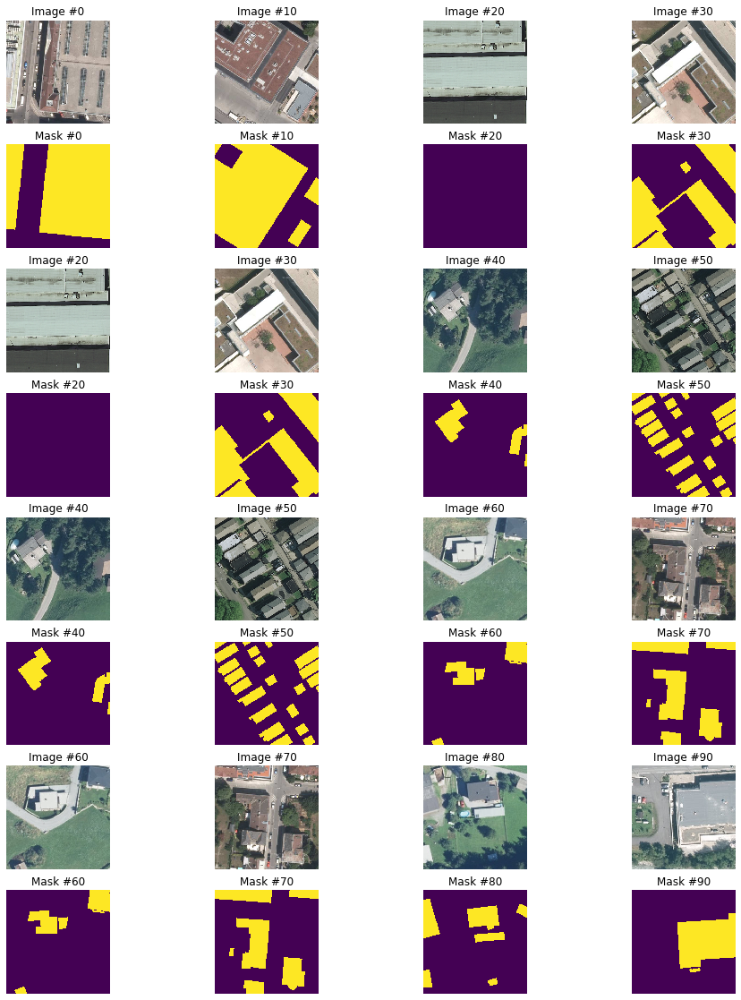

In [7]:
# Illustrate the train images and masks
plt.figure(figsize=(16,20))

x, y = 4,4
for i in range(y):  
    for j in range(x):
        plt.subplot(y*2, x, i*2*x+j+1)
        pos = i*20 + j*10
        #print(pos)
        plt.imshow(X_train_s[pos])
        plt.title('Image #{}'.format(pos))
        plt.axis('off')
        plt.subplot(y*2, x, (i*2+1)*x+j+1)
        
        #We display the associated mask we just generated above with the training image
        plt.imshow(np.squeeze(Y_train_s[pos]))
        plt.title('Mask #{}'.format(pos))
        plt.axis('off')
        
plt.show()

# 4. METRICS and LOSS functions

We need to define a metric to show how close are the predicted mask images and the true mask images in our data set.
For this purpose, the following iou metric from kaggle was used:
    https://www.kaggle.com/aglotero/another-iou-metric
    
I have also used soft dice metric as another common metric.

## 4.1 INTERSECTION OVER UNION METRICS

In [6]:
def iou_metric(y_true_in, y_pred_in, print_table=False):
    labels = label(y_true_in > 0.5)
    y_pred = label(y_pred_in > 0.5)
    
    true_objects = len(np.unique(labels))
    pred_objects = len(np.unique(y_pred))

    intersection = np.histogram2d(labels.flatten(), y_pred.flatten(), bins=(true_objects, pred_objects))[0]

    # Compute areas (needed for finding the union between all objects)
    area_true = np.histogram(labels, bins = true_objects)[0]
    area_pred = np.histogram(y_pred, bins = pred_objects)[0]
    area_true = np.expand_dims(area_true, -1)
    area_pred = np.expand_dims(area_pred, 0)

    # Compute union
    union = area_true + area_pred - intersection

    # Exclude background from the analysis
    intersection = intersection[1:,1:]
    union = union[1:,1:]
    union[union == 0] = 1e-9

    # Compute the intersection over union
    iou = intersection / union

    # Precision helper function
    def precision_at(threshold, iou):
        matches = iou > threshold
        true_positives = np.sum(matches, axis=1) == 1   # Correct objects
        false_positives = np.sum(matches, axis=0) == 0  # Missed objects
        false_negatives = np.sum(matches, axis=1) == 0  # Extra objects
        tp, fp, fn = np.sum(true_positives), np.sum(false_positives), np.sum(false_negatives)
        return tp, fp, fn

    # Loop over IoU thresholds
    prec = []
    if print_table:
        print("Thresh\tTP\tFP\tFN\tPrec.")
    for t in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = precision_at(t, iou)
        if (tp + fp + fn) > 0:
            p = tp / (tp + fp + fn)
        else:
            p = 0
        if print_table:
            print("{:1.3f}\t{}\t{}\t{}\t{:1.3f}".format(t, tp, fp, fn, p))
        prec.append(p)
    
    if print_table:
        print("AP\t-\t-\t-\t{:1.3f}".format(np.mean(prec)))
    return np.mean(prec)

def iou_metric_batch(y_true_in, y_pred_in):
    batch_size = y_true_in.shape[0]
    metric = []
    for batch in range(batch_size):
        value = iou_metric(y_true_in[batch], y_pred_in[batch])
        metric.append(value)
    return np.array(np.mean(metric), dtype=np.float32)

def my_iou_metric(label, pred):
    metric_value = tf.py_func(iou_metric_batch, [label, pred], tf.float32)
    return metric_value


def soft_dice_loss(y_true, y_pred, epsilon=1e-6): 
    ''' 
    Soft dice loss calculation for arbitrary batch size, number of classes, and number of spatial dimensions.
    Assumes the `channels_last` format.
  
    # Arguments
        y_true: b x X x Y( x Z...) x c One hot encoding of ground truth
        y_pred: b x X x Y( x Z...) x c Network output, must sum to 1 over c channel (such as after softmax) 
        epsilon: Used for numerical stability to avoid divide by zero errors
    
    # References
        V-Net: Fully Convolutional Neural Networks for Volumetric Medical Image Segmentation 
        https://arxiv.org/abs/1606.04797
        More details on Dice loss formulation 
        https://mediatum.ub.tum.de/doc/1395260/1395260.pdf (page 72)
        
        Adapted from https://github.com/Lasagne/Recipes/issues/99#issuecomment-347775022
    '''
    
    # skip the batch and class axis for calculating Dice score
    axes = tuple(range(1, len(y_pred.shape)-1)) 
    numerator = 2. * np.sum(y_pred * y_true, axes)
    denominator = np.sum(np.square(y_pred) + np.square(y_true), axes)
    
    return np.mean(numerator / (denominator + epsilon)) # average over classes and batch

## 4.2 Combination of binary cross entropy and dice as loss function

Binary cross entropy have successfully used in training procedure of image segmentation problems.
To get higher accuracy results in semantic labeling the combination of this loss function and dice loss function was used.

In [7]:
def dice_bce_loss(y_true, y_pred):
    def dice_loss(y_true, y_pred):
        numerator = 2 * tf.reduce_sum(y_true * y_pred, axis = (1,2,3))
        denominator = tf.reduce_sum(y_true + y_pred , axis = (1,2,3))
        return tf.reshape(1- (numerator+1)/ (denominator+1), (-1, 1, 1))
    return binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)

# 5. BUILDING UNET MODEL

Here, the pretrained weights of VGG16 network was used to increase the learning speed of the final unet network.
The final unet structue is created on top of the VGG16 network.

## 5.1 VGG16 with pretrained weights from imagenet

In [10]:
from keras.applications import VGG16
#Loads the VGG16 model 
vgg16 = VGG16(weights = 'imagenet', 
                 include_top = False, 
                 input_shape = (IMG_HEIGHT, IMG_WIDTH, 3))


## 5.2 FREEZE ALL LAYERS AND ADD TOP MODEL

According to my experience freezing the weights of vgg16 layers and then training the network does not improve the learning speed.
Therefore, I chose to train the entrie network without freezing.

In [25]:
# freeze the layers
#for layer in vgg16.layers:
#    layer.trainable = True
layers = []  
layers_name = []
# Let's print our layers 
for (i,layer) in enumerate(vgg16.layers):
    print(str(i) + " "+ layer.__class__.__name__, layer.trainable)
    layers.append(layer.output)
    layers_name.append(layer.__class__.__name__)

0 InputLayer True
1 Conv2D True
2 Conv2D True
3 MaxPooling2D True
4 Conv2D True
5 Conv2D True
6 MaxPooling2D True
7 Conv2D True
8 Conv2D True
9 Conv2D True
10 MaxPooling2D True
11 Conv2D True
12 Conv2D True
13 Conv2D True
14 MaxPooling2D True
15 Conv2D True
16 Conv2D True
17 Conv2D True
18 MaxPooling2D True


## 5.3 Adding top model to the VGG16

Here, I have used upsampling2d strategy to increase the training speed as I had a problem with my laptop memory allocation. But, I recommend to uncomment the commented parts of the codes in the future.
As in standard Dropout, the strongly correlated pixel can remain in the next layer, we use the spatial dropout to do dropout across the entire feature map.

In [13]:
def addTopModelVGG16(bottom_model, layers, DropoutRatio=0.5):

    top_model = bottom_model.output
    c1 = Conv2D(512, (3, 3),
                padding='same')(top_model)
    c1 = BatchNormalization()(c1)
    c1 = Activation('relu')(c1)

    c1 = Conv2D(256, (3, 3),
                padding='same')(c1)
    c1 = BatchNormalization()(c1)
    c1 = Activation('relu')(c1)
    #u1 = Conv2DTranspose(256, (3, 3), strides=(2, 2), padding='same')(c1)
    #u1 = BatchNormalization()(u1)
    #u1 = Activation('relu')(u1)
    u1 = UpSampling2D(size=(2, 2))(c1)
    u1 = concatenate([u1, layers[17]])
    u1 = Dropout(DropoutRatio / 2)(u1)
    u1 = Conv2D(256, (3, 3),
                padding='same')(u1)
    u1 = BatchNormalization()(u1)
    u1 = Activation('relu')(u1)

    #u2 = Conv2DTranspose(256, (3, 3), strides=(2, 2), padding='same')(u1)
    u2 = UpSampling2D(size=(2, 2))(u1)
    #u2 = BatchNormalization()(u2)
    #u2 = Activation('relu')(u2)

    u2 = concatenate([u2, layers[13]])
    #u2 = Dropout(DropoutRatio)(u2)
    u2 = Conv2D(256, (3, 3),
                padding='same')(u2)
    u2 = BatchNormalization()(u2)
    u2 = Activation('relu')(u2)

    #u3 = Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same')(u2)
    u3 = UpSampling2D(size=(2, 2))(u2)
    #u3 = BatchNormalization()(u3)
    #u3 = Activation('relu')(u3)

    u3 = concatenate([u3, layers[9]])
    #u3 = Dropout(DropoutRatio)(u3)
    u3 = Conv2D(128, (3, 3),
                padding='same')(u3)
    u3 = BatchNormalization()(u3)
    u3 = Activation('relu')(u3)
    #u4 = Conv2DTranspose(64, (3, 3),
    #                     strides=(2, 2),
    #                     activation='relu',
    #                     padding='same')(u3)
    u4 = UpSampling2D(size=(2, 2))(u3)
    #u4 = BatchNormalization()(u4)
    #u4 = Activation('relu')(u4)
    u4 = concatenate([u4, layers[5]])
    #u4 = Dropout(DropoutRatio)(u4)
    u4 = Conv2D(64, (3, 3),
                activation='relu',
                kernel_initializer='he_normal',
                padding='same')(u4)
    u4 = BatchNormalization()(u4)
    u4 = Activation('relu')(u4)
    #u5 = Conv2DTranspose(32, (3, 3),
    #                     strides=(2, 2),
    #                     activation='relu',
    #                     padding='same')(u4)
    #u5 = BatchNormalization()(u5)
    #u5 = Activation('relu')(u5)
    u5 = UpSampling2D(size=(2, 2))(u4)
    u5 = concatenate([u5, layers[2]])
    u5 = SpatialDropout2D(DropoutRatio/2)(u5)
    #u5 = Dropout(DropoutRatio/2)(u5)
    #u5 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u5)
    top_model = Conv2D(1, (1, 1), activation='sigmoid')(u5)

    return top_model

## 5.4 create the MODEL and Print model summary

In [34]:
FC_Head = addTopModelVGG16(vgg16, layers)

model = Model(inputs=vgg16.input, outputs=FC_Head)
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=[my_iou_metric])
model_diagrams_path = '/home/lenovo/AerialImageDataset_red/model/'
from contextlib import redirect_stdout

with open(model_diagrams_path+'modelsummary.txt', 'w') as f:
    with redirect_stdout(f):
        model.summary()

print(model.summary())

Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 224, 224, 3)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 224, 224, 64) 1792        input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 224, 224, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 112, 112, 64) 0           block1_conv2[0][0]               
___________________________________________________________________________________________

## 5.5 plot and save the model

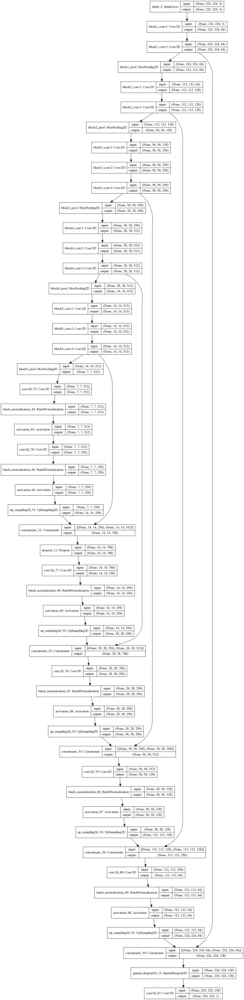

In [35]:
from keras.utils.vis_utils import plot_model
# Save our model diagrams to this path

# Generate the plot
tf.compat.v2.keras.utils.plot_model(model, to_file = model_diagrams_path + 'model_plot_unet.png',
           show_shapes = True,
           show_layer_names = True)

# 6. TRAINING the MODEL

In this section, training and validation images are used to adjust the weights of the network.
Reducing learning rate, early stopping method and check points are callback of the model.

In [ ]:
model_path = "/home/lenovo/AerialImageDataset_red/model/model_aerial_images_224_iou_final_19_1.h5"
checkpoint = ModelCheckpoint(model_path,
                             monitor="my_iou_metric",
                             mode="max",
                             save_best_only=True,
                             save_weights_only= False,
                             verbose=1)

earlystop = EarlyStopping(monitor='my_iou_metric',
                          min_delta=0,
                          patience=45,
                          verbose=1,
                          restore_best_weights=True)
Reduce_LR = ReduceLROnPlateau(monitor='my_iou_metric',
                              mode='max',
                              factor=0.5,
                              patience=10,
                              min_lr=0.0001,
                              verbose=1)

#callbacks = [earlystop, checkpoint, Reduce_LR]
callbacks = [checkpoint, Reduce_LR]

batch_size = 4
epochs = 50

# Fit our model
results = model.fit(X_train,
                    Y_train,
                    validation_data=[X_valid, Y_valid],
                    epochs=epochs,
                    batch_size=batch_size,
                    callbacks=callbacks)


# 7. Generating prediction over training and validation data

After training the model, we test its performance on some of the traing and test images.

In [8]:
#loading model
from keras.losses import binary_crossentropy
model = load_model("/home/lenovo/AerialImageDataset_red/model/model_aerial_images_224_iou_final_19.h5", 
                   custom_objects={'my_iou_metric': my_iou_metric, 'dice_bce_loss':dice_bce_loss })









Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Instructions for updating:
tf.py_func is deprecated in TF V2. Instead, there are two
    options available in V2.
    - tf.py_function takes a python function which manipulates tf eager
    tensors instead of numpy arrays. It's easy to convert a tf eager tensor to
    an ndarray (just call tensor.numpy()) but having access to eager tensors
    means `tf.py_function`s can use accelerators such as GPUs as well as
    being differentiable using a gradient tape.
    - tf.numpy_function maintains the semantics of the deprecated tf.py_func
    (it is not differentiable, and manipulates numpy arrays). It drops the
    stateful argument making all functions stateful.
    


### Showing our predicted masks on our training data

967
my_IOU : 0.3548701298701299
DICE : 0.1775150579261445
3539
my_IOU : 0.5
DICE : 0.07828439963331038
1820
my_IOU : 0.4
DICE : 0.06162305592316591
1691
my_IOU : 0.7485714285714286
DICE : 0.4774192447087449
155
my_IOU : 0.3023232323232323
DICE : 0.15292163910040496
2703
my_IOU : 0.26223776223776224
DICE : 0.21534188850252514
4013
my_IOU : 0.20833333333333331
DICE : 0.05265462928493025


/home/lenovo/.local/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


5228
my_IOU : 0.31829752634706193
DICE : 0.16733091123250357
169
my_IOU : 0.6666666666666667
DICE : 0.27078669496379537
3412
my_IOU : 0.37555555555555553
DICE : 0.22542638601129678
2428
my_IOU : 0.3333333333333333
DICE : 0.06566881282885889
2642
my_IOU : 0.5152380952380953
DICE : 0.3680841590701654
4752
my_IOU : 0.24664222047286563
DICE : 0.17358888004229464
4342
my_IOU : 0.21071428571428572
DICE : 0.08219064768018636
2790
my_IOU : 0.8
DICE : 0.05460775330836824
175
my_IOU : 0.35
DICE : 0.16697217416697413
5227
my_IOU : 0.9333333333333333
DICE : 0.09733732378031772
1828
my_IOU : 0.27999999999999997
DICE : 0.09050138969828474
4665
my_IOU : 0.24500000000000002
DICE : 0.0859773167052192
4126
my_IOU : 0.24888888888888888
DICE : 0.12211011113882199
1832
my_IOU : 0.32
DICE : 0.046675678192773136
2144
my_IOU : 0.3
DICE : 0.0632971622289699
4172
my_IOU : 0.20647893772893777
DICE : 0.13725678723895332
702
my_IOU : 0.23361111111111113
DICE : 0.16669315644934016
5335
my_IOU : 0.5342268842268842
D

<Figure size 1152x1440 with 0 Axes>

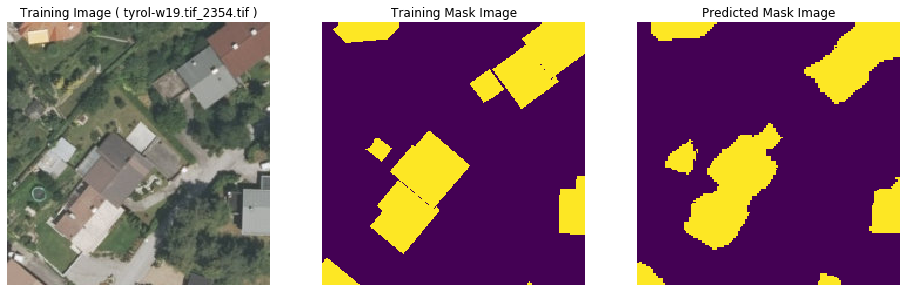

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

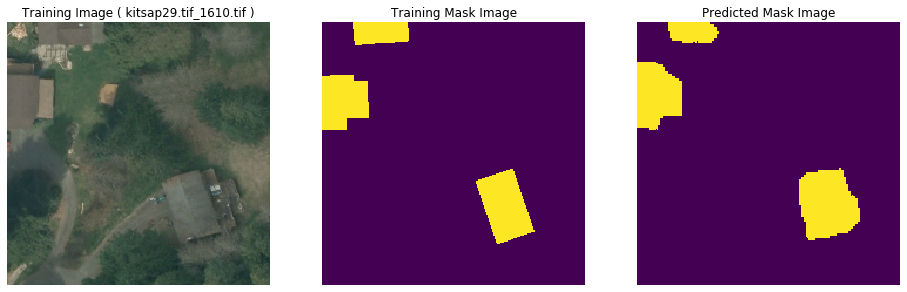

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

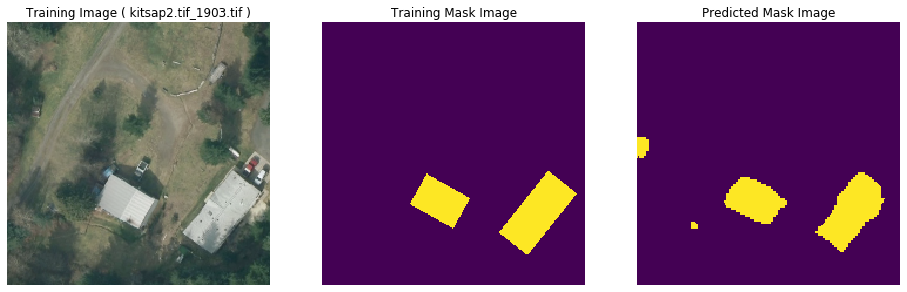

<Figure size 1152x1440 with 0 Axes>

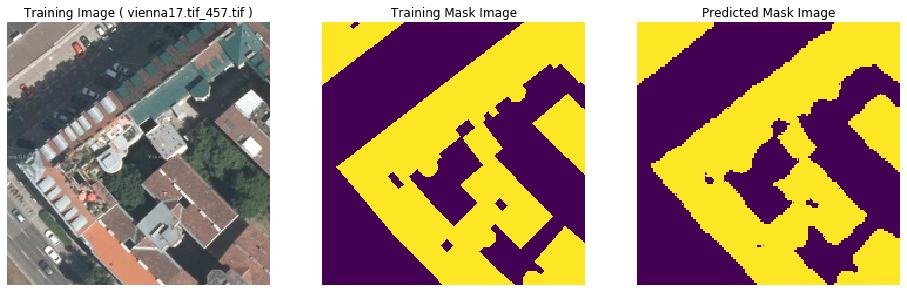

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

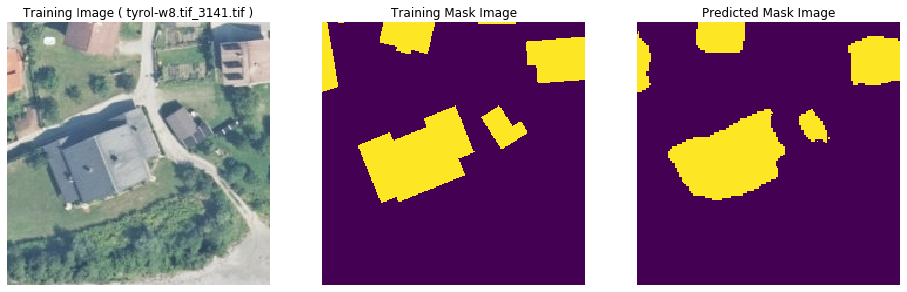

<Figure size 1152x1440 with 0 Axes>

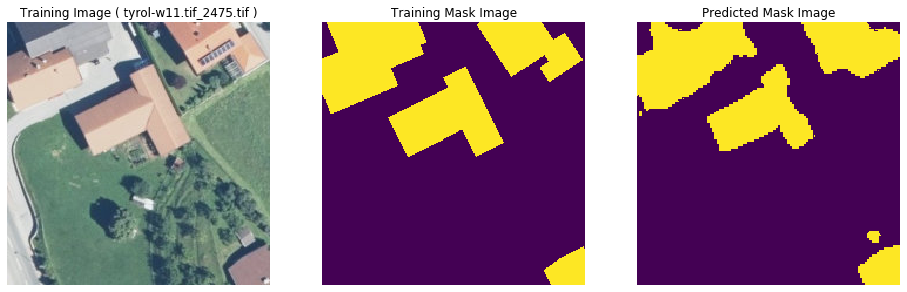

<Figure size 1152x1440 with 0 Axes>

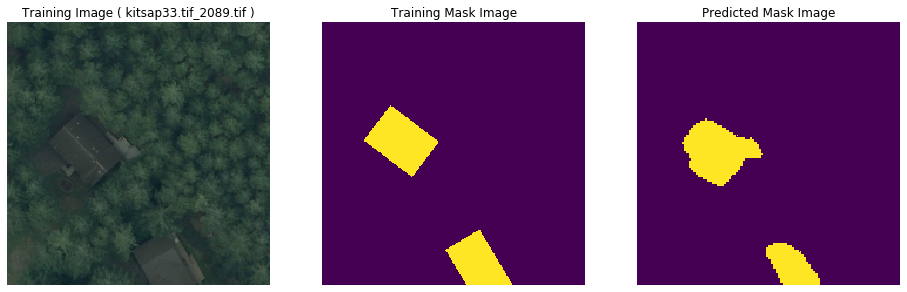

<Figure size 1152x1440 with 0 Axes>

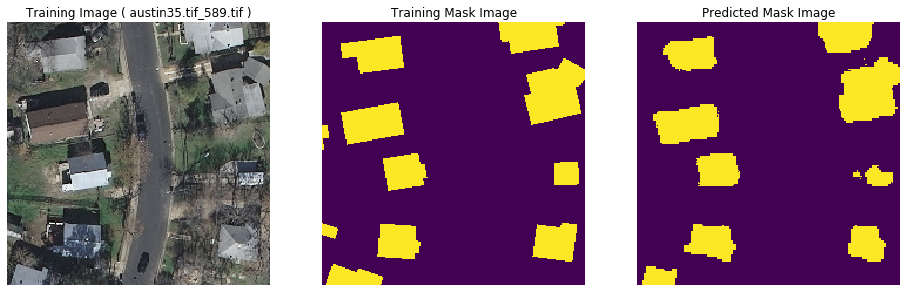

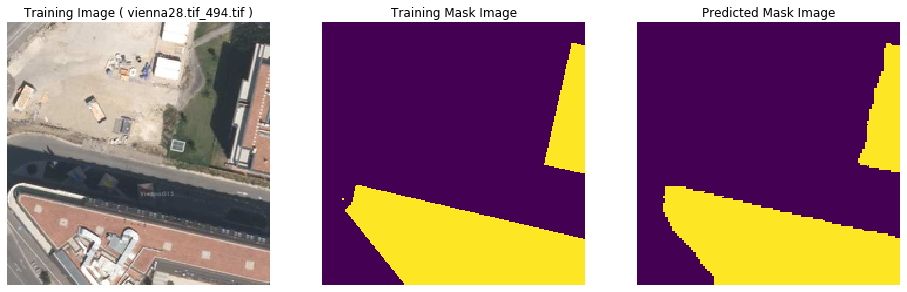

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

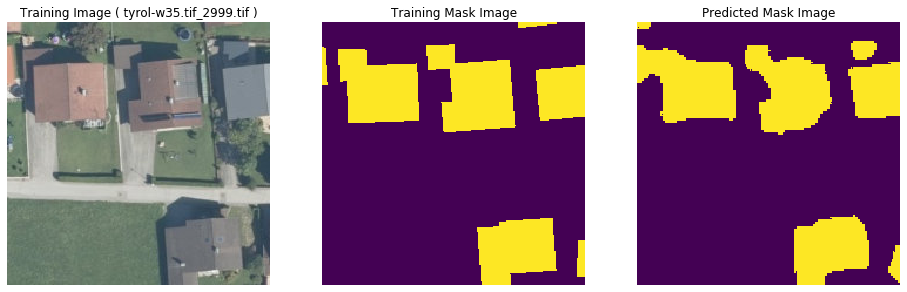

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

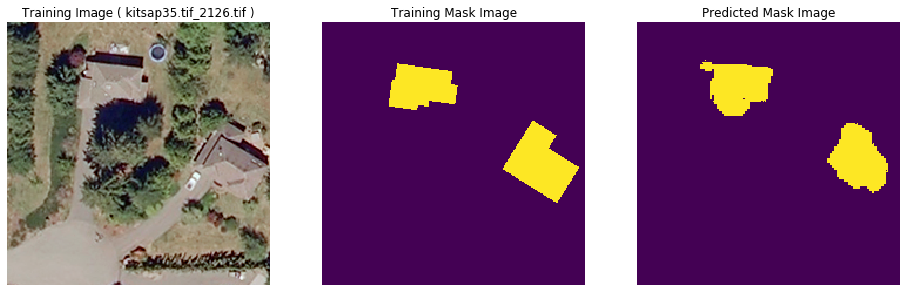

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

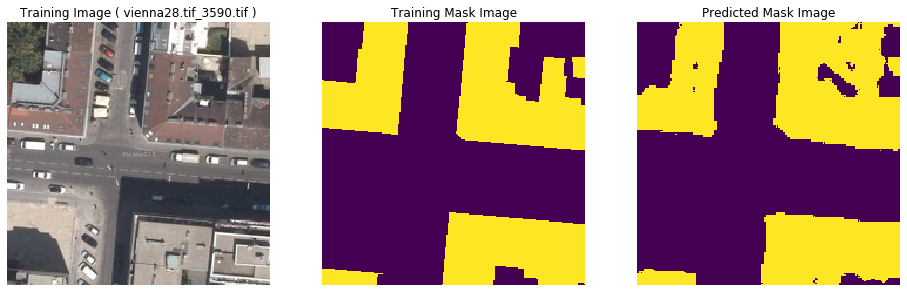

<Figure size 1152x1440 with 0 Axes>

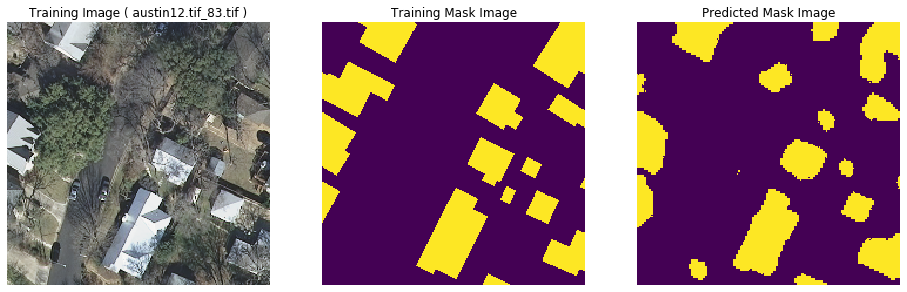

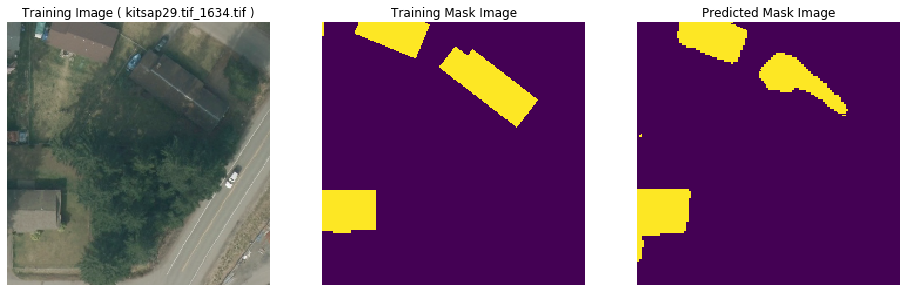

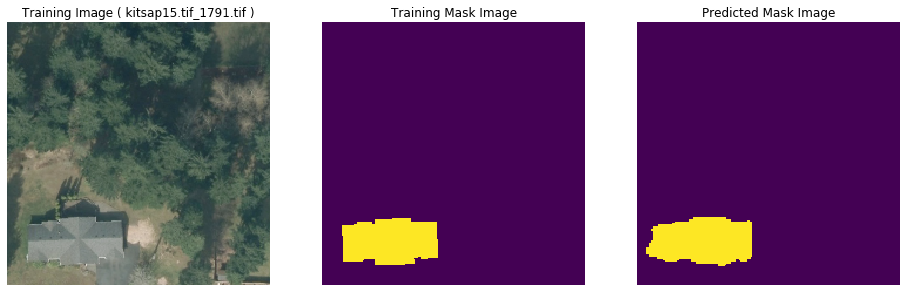

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

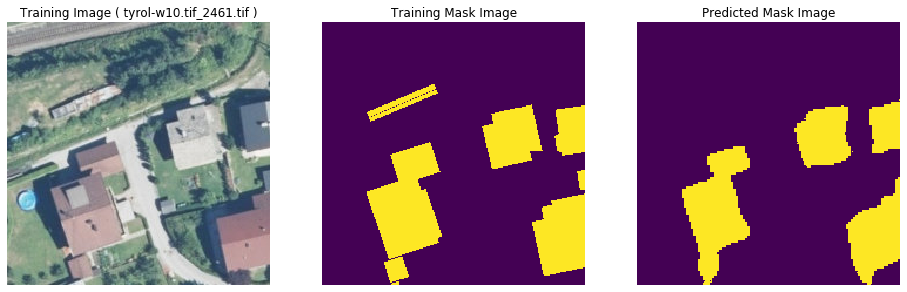

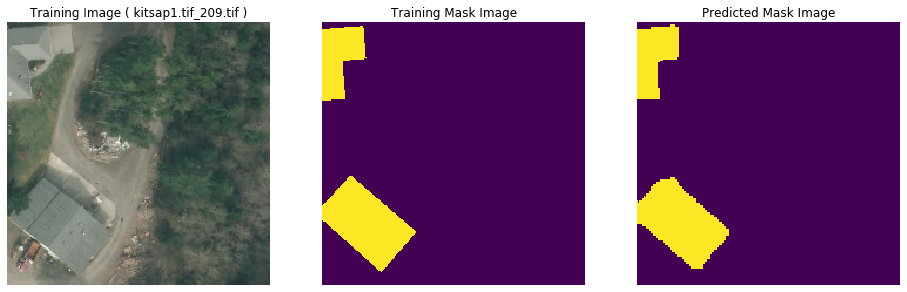

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

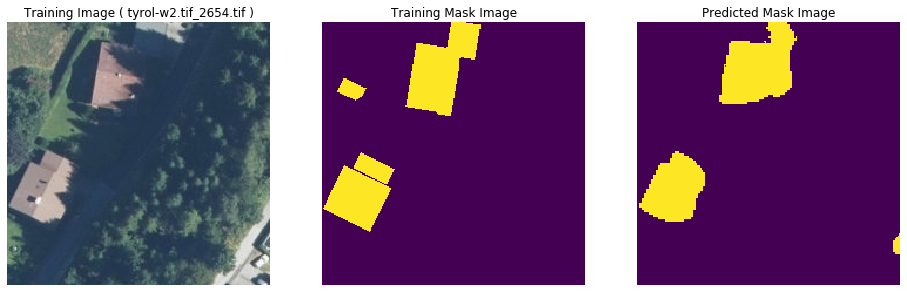

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

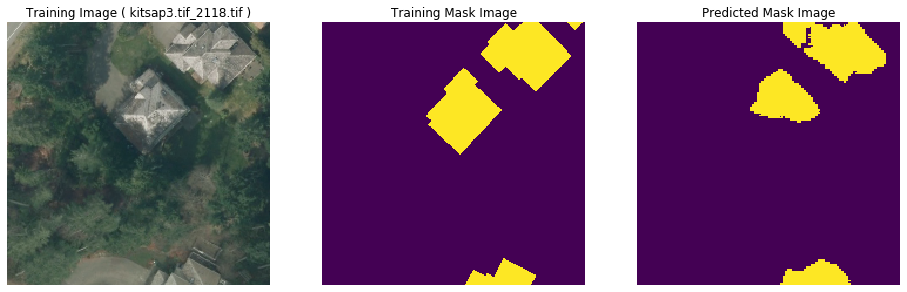

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

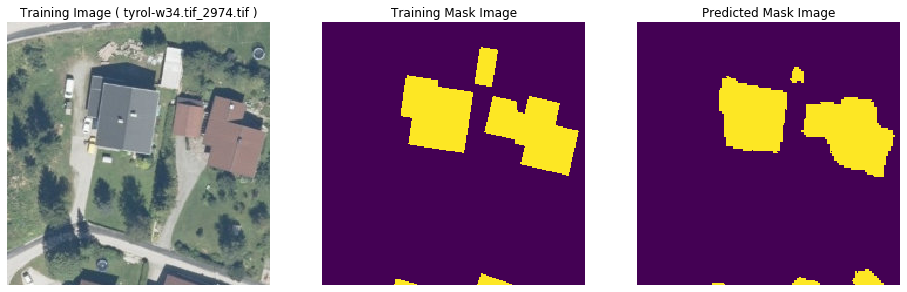

<Figure size 1152x1440 with 0 Axes>

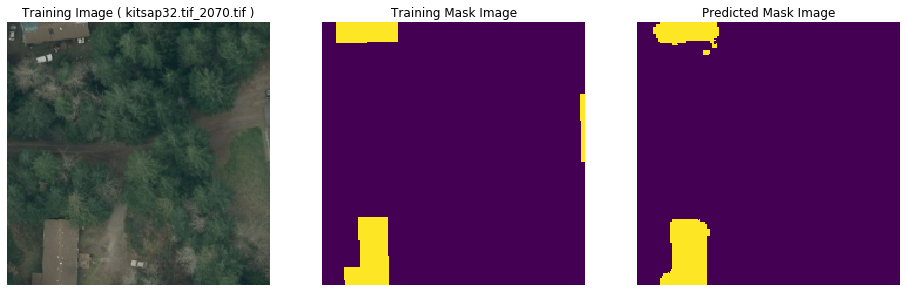

<Figure size 1152x1440 with 0 Axes>

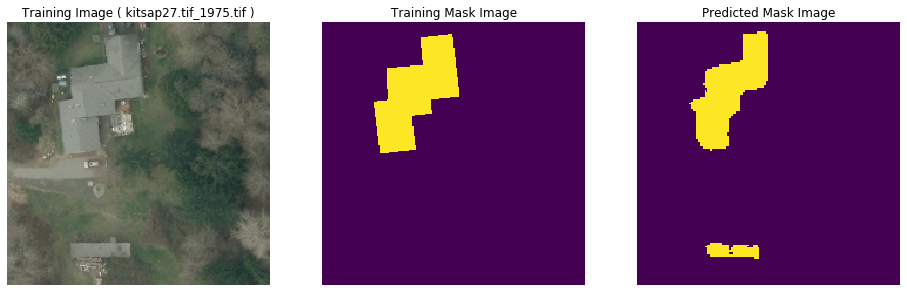

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

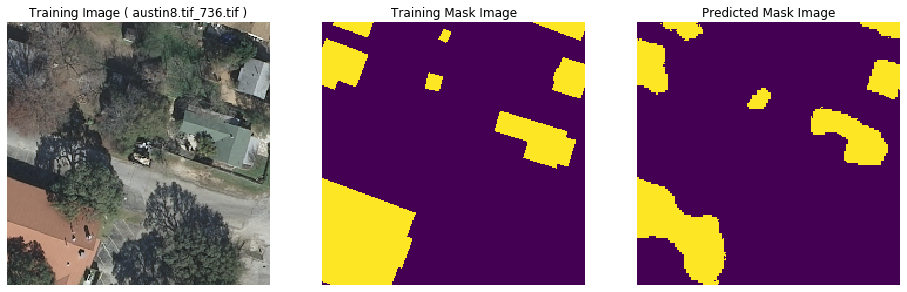

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

<Figure size 1152x1440 with 0 Axes>

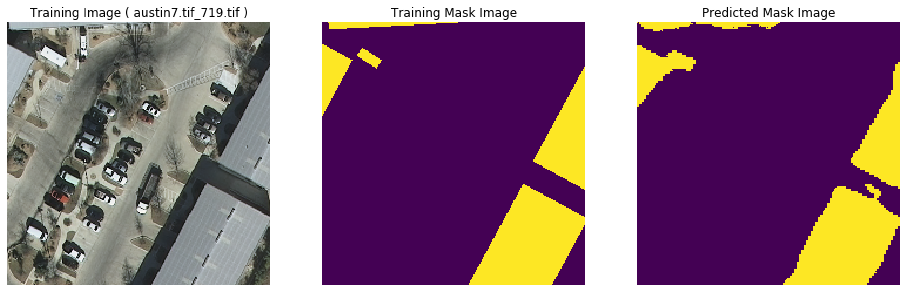

<Figure size 1152x1440 with 0 Axes>

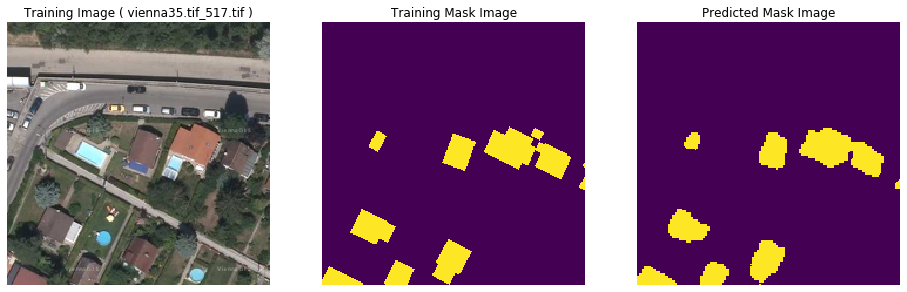

In [11]:
output_path_train = '/home/lenovo/AerialImageDataset_red/Train_results/'
# Illustrate the train images and masks
plt.figure(figsize=(16,20))
metrics1 = []
metrics2 = []
i = 0
while i < 25:#range(len(train_ids)):
    plt.figure(figsize=(16,20))
    num = random.randint(0, len(X_train))
    ix = num

    inp_image = np.expand_dims(X_train[ix], axis=0)
    preds_train = model.predict(inp_image, verbose=0)
    preds_train_t = (preds_train > 0.5).astype(np.uint8)
    iou = iou_metric(np.squeeze(Y_train_s[ix]), np.squeeze(preds_train_t), print_table=False)
    softdice = soft_dice_loss(np.squeeze(Y_train_s[ix]), np.squeeze(preds_train_t), epsilon=1e-6)
    metrics1.append(iou)
    metrics2.append(softdice)
    # training image
    if iou > 0.20:
        i += 1
        print(ix)
        print('my_IOU : {}'.format(iou))
        print('DICE : {}'.format(softdice))
        plt.subplot(1, 3, 1)
        out = X_train_s[ix] 
        plt.imshow(out)
        plt.title('Training Image ( '+ train_ids[ix] + ' )')
        plt.axis('off')

        # training mask image
        plt.subplot(1, 3, 2)
        plt.imshow(np.squeeze(Y_train_s[ix]))
        plt.title('Training Mask Image')
        plt.axis('off')

        # predicted mask image
        plt.subplot(1, 3, 3)
        plt.imshow(np.squeeze(preds_train_t!=0))
        plt.title('Predicted Mask Image')
        plt.axis('off')
        output = output_path_train + train_ids[ix]
        plt.savefig(output, bbox_inches="tight")
plt.show()

#### computing average performance of two metrics on training set

Dice: 0.17464870830100046
my_iou: 0.18761129145769695


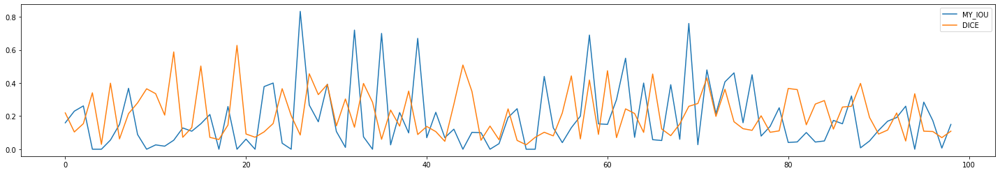

In [27]:

metrics1 = np.asarray(metrics1)
metrics2 = np.asarray(metrics2)
#print(np.corrcoef(metrics1, metrics2))
print('Dice: {}'.format(np.mean(metrics1)))
print('my_iou: {}'.format(np.mean(metrics2)))
plt.figure(figsize=(25,4))
plt.plot(metrics1[1:100])
plt.plot(metrics2[1:100])
plt.legend(['MY_IOU','DICE'])


In [12]:
iou_metric(np.squeeze(Y_train_s[ix]), np.squeeze(preds_train_t), print_table=True)

Thresh	TP	FP	FN	Prec.
0.500	8	1	2	0.727
0.550	8	1	2	0.727
0.600	8	1	2	0.727
0.650	8	1	2	0.727
0.700	8	1	2	0.727
0.750	8	1	2	0.727
0.800	6	3	4	0.462
0.850	6	3	4	0.462
0.900	1	8	9	0.056
0.950	0	9	10	0.000
AP	-	-	-	0.534


0.5342268842268842

In [13]:
soft_dice_loss(np.squeeze(Y_train_s[ix]), np.squeeze(preds_train_t), epsilon=1e-6)

0.08207106865834324

### Generating our predictions for test data

1021
1/1 [==============================] - 1s 1s/step
643
1/1 [==============================] - 1s 937ms/step
1739
1/1 [==============================] - 1s 911ms/step
1510
1/1 [==============================] - 1s 905ms/step
1
1/1 [==============================] - 1s 948ms/step
1078
1/1 [==============================] - 1s 960ms/step
1944
1/1 [==============================] - 1s 919ms/step
3139
1/1 [==============================] - 1s 929ms/step
1770
1/1 [==============================] - 1s 913ms/step
130
1/1 [==============================] - 1s 941ms/step
688
1/1 [==============================] - 1s 948ms/step
2697
1/1 [==============================] - 1s 915ms/step
511
1/1 [==============================] - 1s 927ms/step
3117
1/1 [==============================] - 1s 926ms/step
2193
1/1 [==============================] - 1s 929ms/step
500
1/1 [==============================] - 1s 930ms/step
3440
1/1 [==============================] - 1s 929ms/step
3316
1/1 [===============

/home/lenovo/.local/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


1/1 [==============================] - 1s 939ms/step
3200
1/1 [==============================] - 1s 1s/step
1392
1/1 [==============================] - 1s 947ms/step
511
1/1 [==============================] - 1s 936ms/step
1134
1/1 [==============================] - 1s 944ms/step
2970
1/1 [==============================] - 1s 925ms/step
1855
1/1 [==============================] - 1s 927ms/step
3682
1/1 [==============================] - 1s 932ms/step
3630
1/1 [==============================] - 1s 932ms/step
668
1/1 [==============================] - 1s 915ms/step
3864
1/1 [==============================] - 1s 925ms/step
3224
1/1 [==============================] - 1s 931ms/step
1985
1/1 [==============================] - 1s 922ms/step
3572
1/1 [==============================] - 1s 908ms/step
2505
1/1 [==============================] - 1s 945ms/step
1459
1/1 [==============================] - 1s 915ms/step
3793
1/1 [==============================] - 1s 944ms/step
1369
1/1 [==============

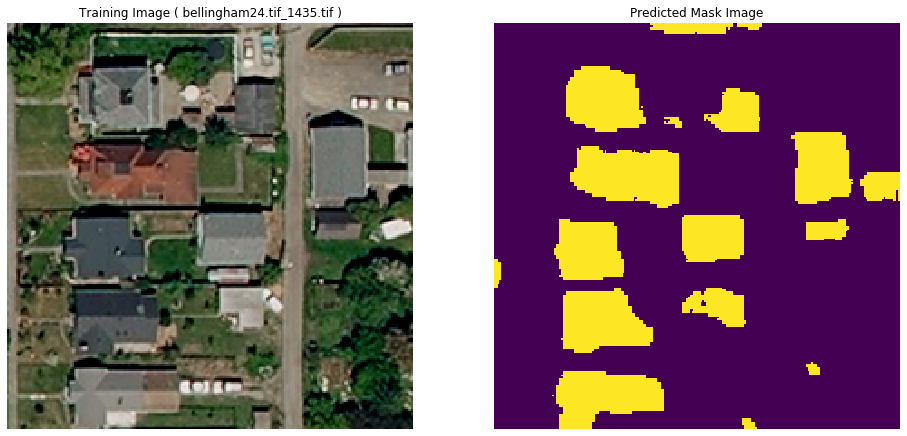

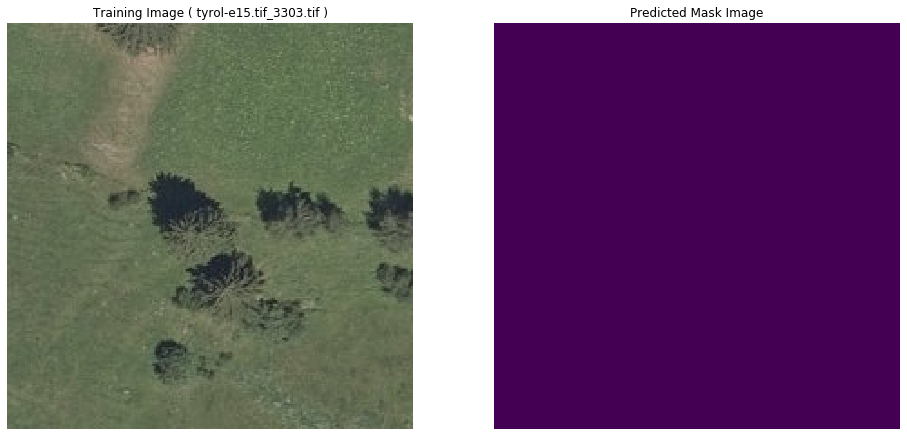

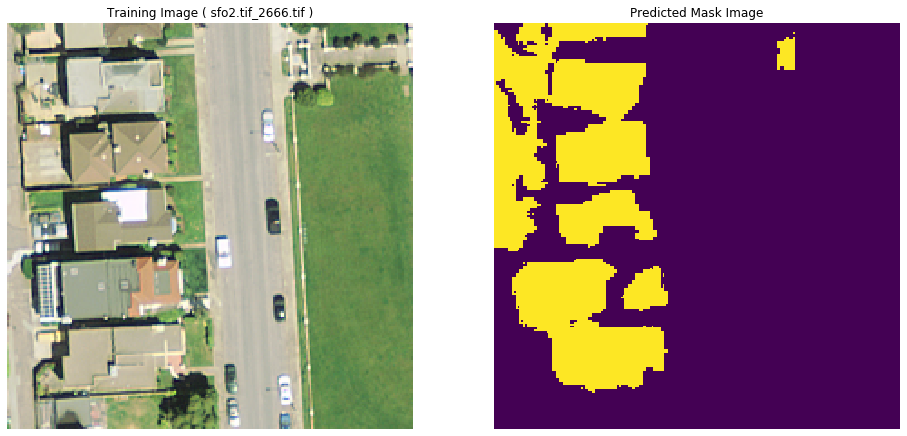

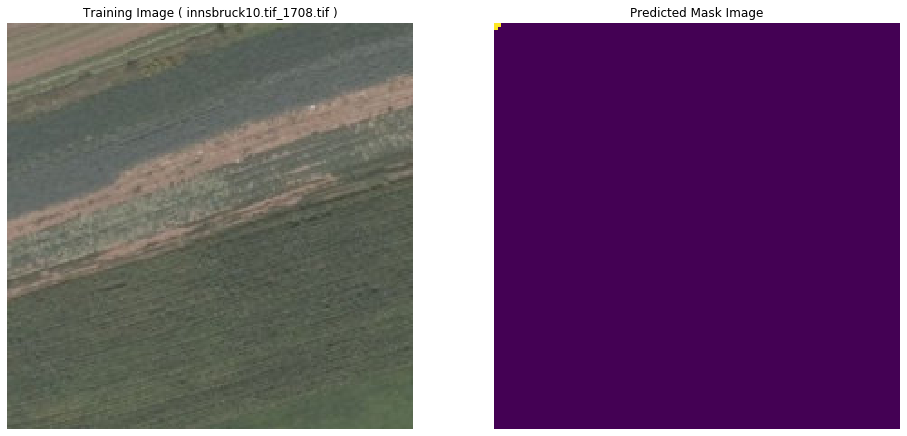

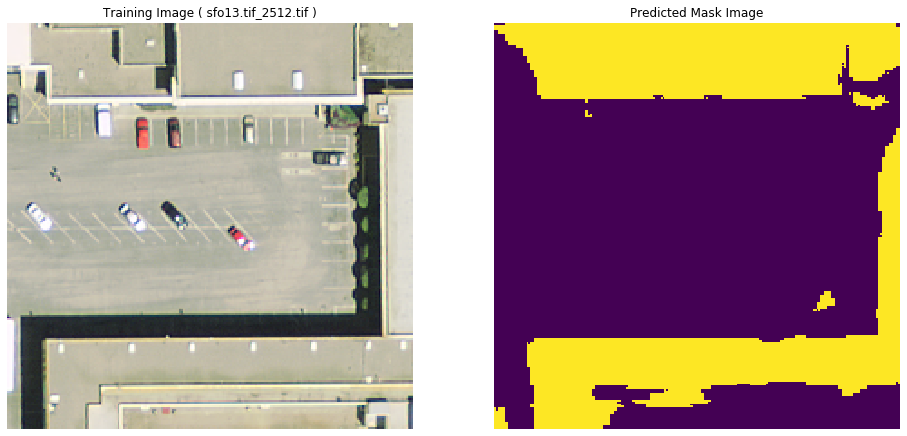

...

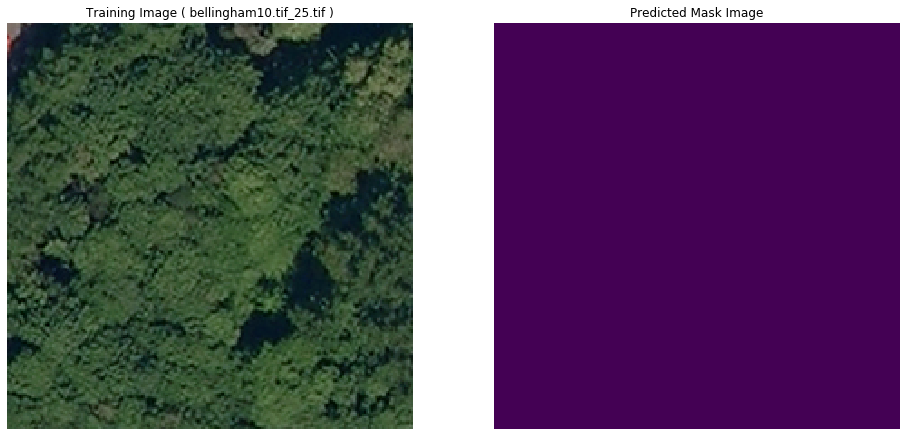

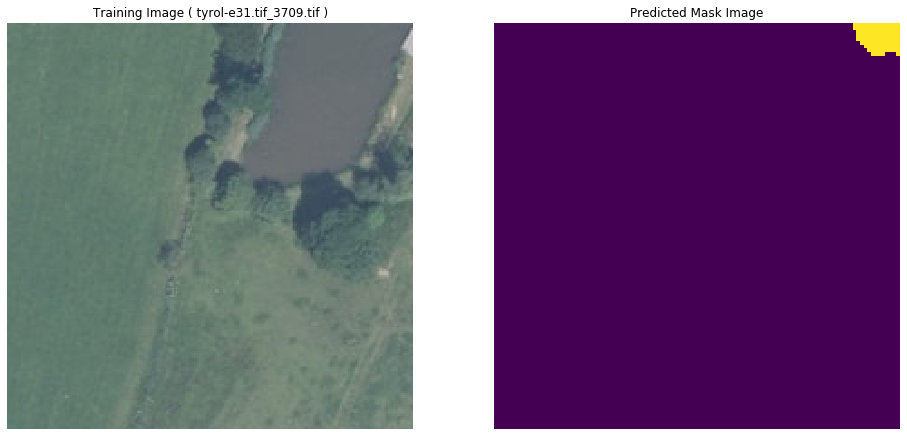

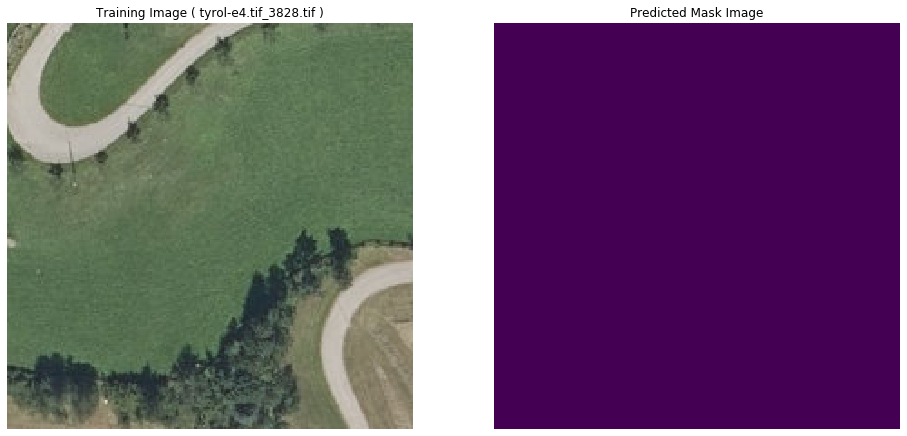

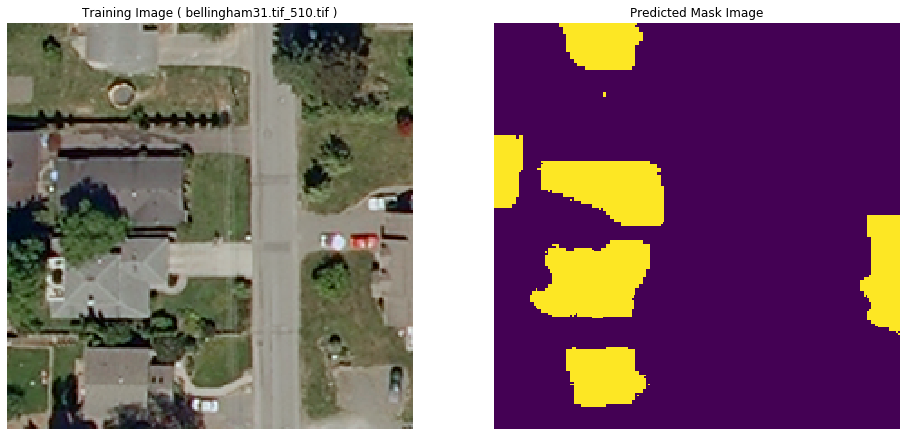

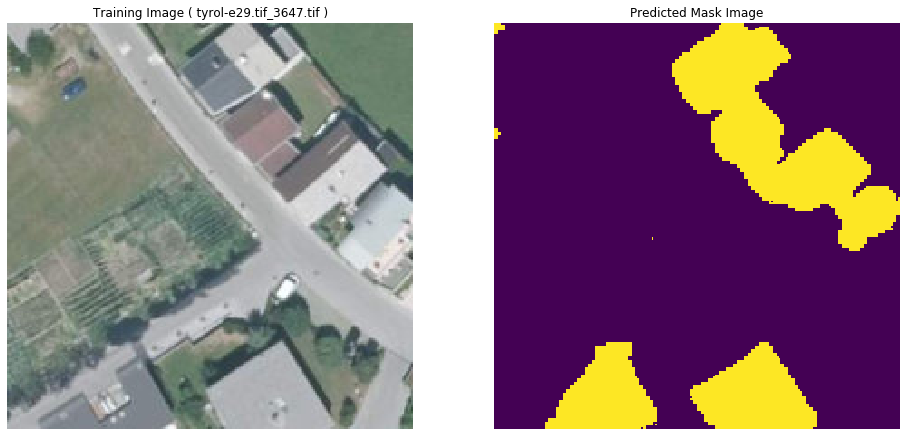

In [9]:
# Ploting our predicted masks
output_path_test = '/home/lenovo/AerialImageDataset_red/Test_results/'
# Illustrate the train images and masks
for i in range(100):#range(len(test_ids)):
    plt.figure(figsize=(16,20))
    ix = random.randint(0, len(X_test))
    print(ix)
    inp_image = np.expand_dims(X_test[ix], axis=0)
    preds_test = model.predict(inp_image, verbose=1)
    preds_test_t = (preds_test > 0.5).astype(np.uint8)
    plt.subplot(1, 2, 1)
    out = X_test_s[ix] 
    #out *= 255.0
    plt.imshow(out)
    plt.title('Training Image ( '+ test_ids[ix] + ' )')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    #We display the associated mask we just generated above with the training image
    plt.imshow(np.squeeze(preds_test_t!=0))
    plt.title('Predicted Mask Image')
    plt.axis('off')
    output = output_path_test + test_ids[ix]
    plt.savefig(output, bbox_inches="tight")
    #imsave(out_name, sub_image)

plt.show()